## Supervised Learning

In supervised learning, the machine is trained on a set of labeled data, which means that the input data is paired with the desired output. The machine then learns to predict the output for new input data. Supervised learning is often used for tasks such as classification, regression, and object detection.
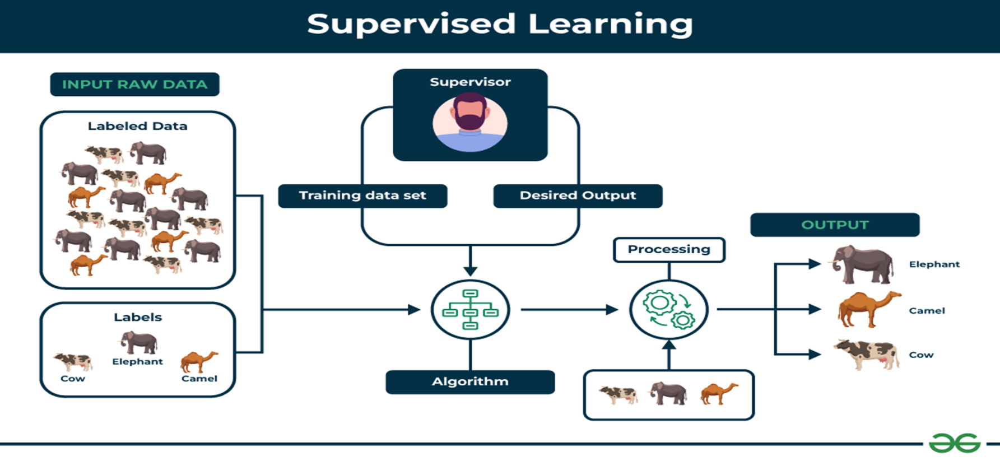

## Unsupervised learning

Unsupervised learning is a type of machine learning that learns from unlabeled data. This means that the data does not have any pre-existing labels or categories. The goal of unsupervised learning is to discover patterns and relationships in the data without any explicit guidance.
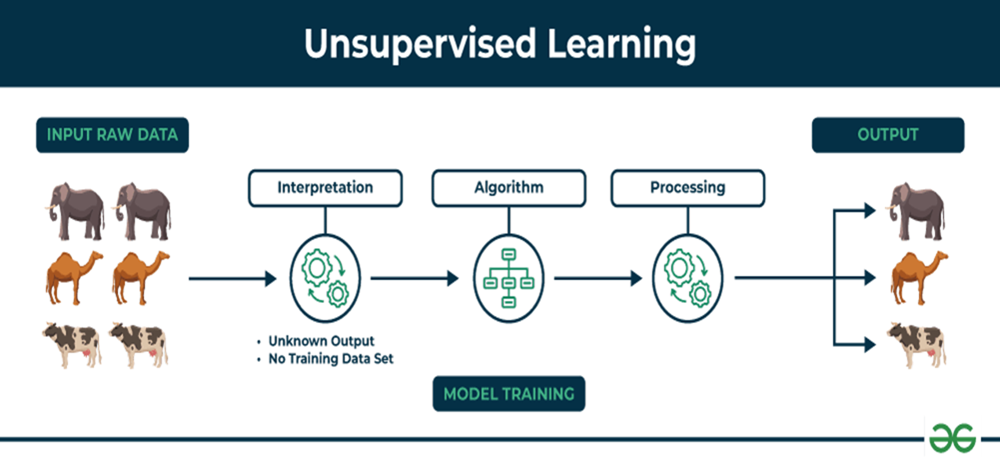

**Types of Unsupervised Learning**
Unsupervised learning is classified into two categories of algorithms: 

**Clustering:** A clustering problem is where you want to discover the inherent groupings in the data, such as grouping customers by purchasing behavior.

**Association**: An association rule learning problem is where you want to discover rules that describe large portions of your data, such as people that buy X also tend to buy 

**Clustering Types:-**
Hierarchical clustering\
K-means clustering\
Principal Component Analysis\
Singular Value Decomposition\
Independent Component Analysis\
Gaussian Mixture Models (GMMs)\
Density-Based Spatial Clustering of Applications with Noise (DBSCAN)\



## What is K-means Clustering?
is the process of teaching a computer to use unlabeled, unclassified data and enabling the algorithm to operate on that data without supervision. Without any previous data training, the machine’s job in this case is to organize unsorted data according to parallels, patterns, and variations.

K means clustering, assigns data points to one of the K clusters depending on their distance from the center of the clusters. It starts by randomly assigning the clusters centroid in the space. Then each data point assign to one of the cluster based on its distance from centroid of the cluster. 

After assigning each point to one of the cluster, new cluster centroids are assigned. This process runs iteratively until it finds good cluster. In the analysis we assume that number of cluster is given in advanced and we have to put points in one of the group.

In some cases, K is not clearly defined, and we have to think about the optimal number of K. K Means clustering performs best data is well separated. When data points overlapped this clustering is not suitable. K Means is faster as compared to other clustering technique. It provides strong coupling between the data points. K Means cluster do not provide clear information regarding the quality of clusters. Different initial assignment of cluster centroid may lead to different clusters. Also, K Means algorithm is sensitive to noise. It maymhave stuck in local minima

## What is the objective of k-means clustering?

The goal of clustering is to divide the population or set of data points into a number of groups so that the data points within each group are more comparable to one another and different from the data points within the other groups. It is essentially a grouping of things based on how similar and different they are to one another

## How k-means clustering works?

We are given a data set of items, with certain features, and values for these features (like a vector). The task is to categorize those items into groups. To achieve this, we will use the K-means algorithm, an unsupervised learning algorithm. ‘K’ in the name of the algorithm represents the number of groups/clusters we want to classify our items into.

(It will help if you think of items as points in an n-dimensional space). The algorithm will categorize the items into k groups or clusters of similarity. To calculate that similarity, we will use the Euclidean distance as a measurement.

The algorithm works as follows:  

First, we randomly initialize k points, called means or cluster centroids.
We categorize each item to its closest mean, and we update the mean’s coordinates, which are the averages of the items categorized in that cluster so far.
We repeat the process for a given number of iterations and at the end, we have our clusters.

The “points” mentioned above are called means because they are the mean values of the items categorized in them. To initialize these means, we have a lot of options. An intuitive method is to initialize the means at random items in the data set. Another method is to initialize the means at random values between the boundaries of the data set (if for a feature x, the items have values in [0,3], we will initialize the means with values for x at [0,3]).

In [15]:
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

In [4]:
import warnings
warnings.filterwarnings("ignore")

In [19]:
# generate sample data
X, y_true = make_blobs(n_samples=300, centers=4, cluster_std=0.6, random_state=0)

# initiate a KMeans object with the number of clusters
kmeans = KMeans(n_clusters=4)
# fit the data to the KMeans algorithm
kmeans.fit(X)

KMeans(n_clusters=4)

In [20]:
labels = kmeans.labels_


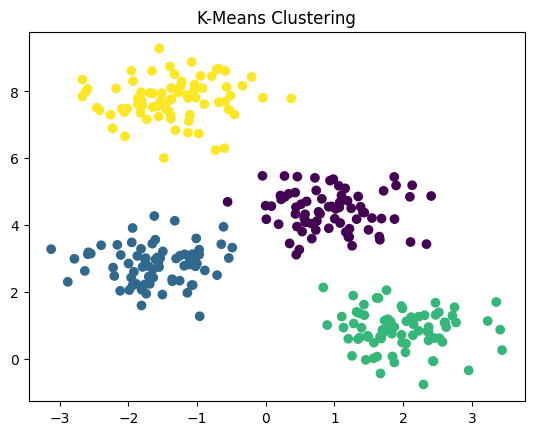

In [21]:
# plot the data points with different colors for different clusters
plt.scatter(X[:, 0], X[:, 1], c=labels)
plt.title('K-Means Clustering')
plt.show()

**Let's practice on diamond dataset**

In [22]:
df=sns.load_dataset("diamonds")
df.head()

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [23]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.cluster import KMeans

In [29]:
X=df[["price","carat"]]

In [30]:
kmeans = KMeans(n_clusters=5)

In [31]:
kmeans.fit(X)

KMeans(n_clusters=5)

In [32]:
labels = kmeans.labels_

In [33]:
df["labels"]=labels

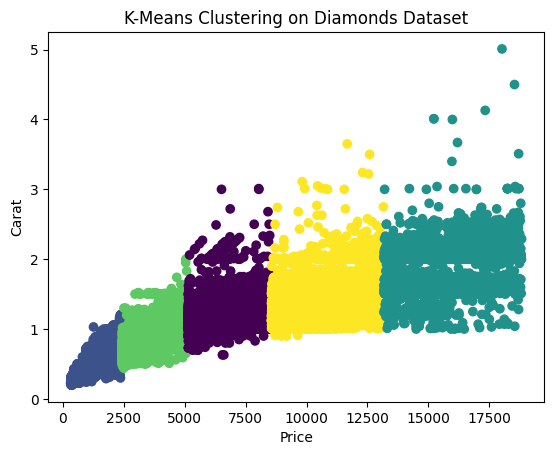

In [38]:
plt.scatter(X["price"], X["carat"], c=labels)
plt.xlabel("Price")
plt.ylabel("Carat")
plt.title('K-Means Clustering on Diamonds Dataset')
plt.show()

<Axes: xlabel='labels', ylabel='price'>

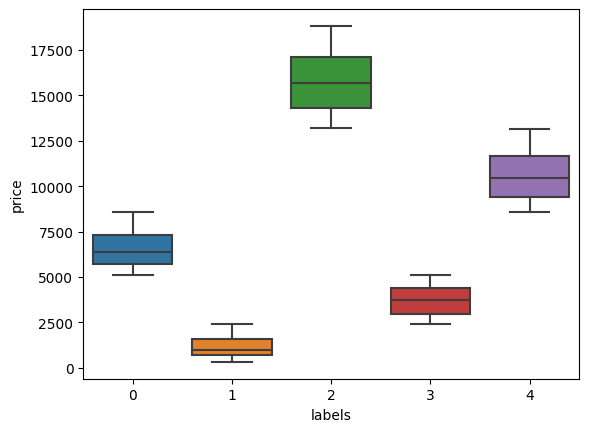

In [39]:
sns.boxplot(x='labels', y='price', data=df)

In [40]:
df.labels.unique()

array([1, 3, 0, 4, 2])

**lets change the number of clusters**

In [41]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans

diamonds = sns.load_dataset('diamonds')
# Select relevant columns
X = diamonds[["carat", "price", "cut", "color", "clarity"]]

# Convert categorical variables to numerical using one-hot encoding
X = pd.get_dummies(X)


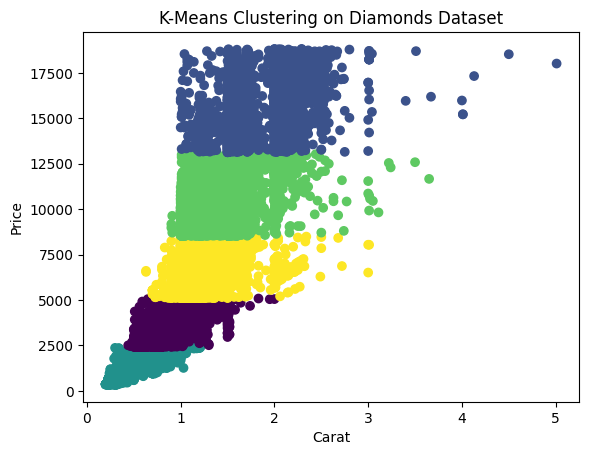

In [43]:
# Instantiate a KMeans object with the number of clusters
kmeans = KMeans(n_clusters=5)

# Fit the data to the KMeans algorithm
kmeans.fit(X)

# Get the predicted cluster labels for each data point
labels = kmeans.labels_

# Add predicted cluster labels as a new column to the original dataset
diamonds['labels'] = labels

# Plot the data points with different colors for different clusters
plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=labels)
plt.xlabel("Carat")
plt.ylabel("Price")
plt.title('K-Means Clustering on Diamonds Dataset')
plt.show()

**Can we plot categorical data? with numerical?**

In [48]:
X.columns

Index(['carat', 'price', 'cut_Ideal', 'cut_Premium', 'cut_Very Good',
       'cut_Good', 'cut_Fair', 'color_D', 'color_E', 'color_F', 'color_G',
       'color_H', 'color_I', 'color_J', 'clarity_IF', 'clarity_VVS1',
       'clarity_VVS2', 'clarity_VS1', 'clarity_VS2', 'clarity_SI1',
       'clarity_SI2', 'clarity_I1'],
      dtype='object')

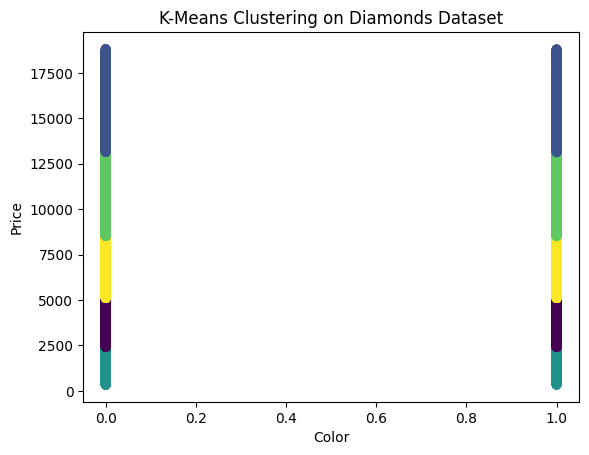

In [46]:
# Plot the data points with different colors for different clusters
plt.scatter(X.iloc[:, 2], X.iloc[:, 1], c=labels)
plt.xlabel("Color")
plt.ylabel("Price")
plt.title('K-Means Clustering on Diamonds Dataset')
plt.show()

**Which kind of input variables can we take in k means clustering?**

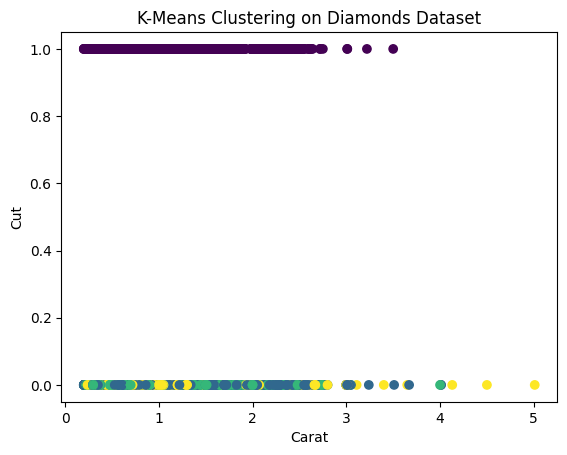

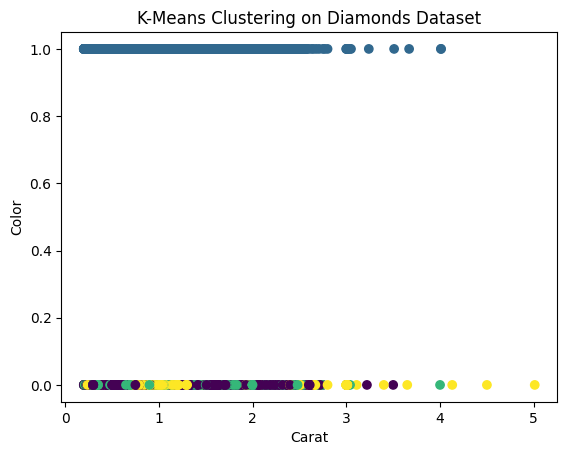

In [49]:
# Select relevant columns
X = diamonds[["carat", "cut", "color"]]

# Convert categorical variables to numerical using one-hot encoding
X = pd.get_dummies(X)

# Instantiate a KMeans object with the number of clusters
kmeans = KMeans(n_clusters=4)

# Fit the data to the KMeans algorithm
kmeans.fit(X)

# Get the predicted cluster labels for each data point
labels = kmeans.labels_

# Add predicted cluster labels as a new column to the original dataset
diamonds['labels'] = labels

# Plot the data points with different colors for different clusters
plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=labels, cmap='viridis')
plt.xlabel("Carat")
plt.ylabel("Cut")
plt.title('K-Means Clustering on Diamonds Dataset')
plt.show()

plt.scatter(X.iloc[:, 0], X.iloc[:, 2], c=labels, cmap='viridis')
plt.xlabel("Carat")
plt.ylabel("Color")
plt.title('K-Means Clustering on Diamonds Dataset')
plt.show()

**Adding cluster labels to the data for further EDA work**

In [50]:
# Select relevant columns
X = diamonds[["carat", "price"]]

# Instantiate a KMeans object with the number of clusters
kmeans = KMeans(n_clusters=5)

# Fit the data to the KMeans algorithm
kmeans.fit(X)

# Get the predicted cluster labels for each data point
labels = kmeans.predict(X)

# Add predicted cluster labels as a new column to the original dataset
diamonds['labels'] = labels

# Display the first few rows of the dataset with the new column added
print(diamonds.head())

#display the unique values of a label
print("These are the unique values of labels: ", sorted(diamonds.labels.unique()))

   carat      cut color clarity  depth  table  price     x     y     z  labels
0   0.23    Ideal     E     SI2   61.5   55.0    326  3.95  3.98  2.43       1
1   0.21  Premium     E     SI1   59.8   61.0    326  3.89  3.84  2.31       1
2   0.23     Good     E     VS1   56.9   65.0    327  4.05  4.07  2.31       1
3   0.29  Premium     I     VS2   62.4   58.0    334  4.20  4.23  2.63       1
4   0.31     Good     J     SI2   63.3   58.0    335  4.34  4.35  2.75       1
These are the unique values of labels:  [0, 1, 2, 3, 4]


In [51]:
kmeans.inertia_

37522619568.02513

## Make a parallel coordinate plot using plotly express

In [52]:
import plotly.express as px
fig = px.parallel_coordinates(diamonds, color="labels")
fig.show() 

## Model Evaluation

**1. Elbow Method**

A fundamental step for any unsupervised algorithm is to determine the optimal number of clusters into which the data may be clustered. Since we do not have any predefined number of clusters in unsupervised learning. We tend to use some method that can help us decide the best number of clusters.  In the case of K-Means clustering, we use Elbow Method for defining the best number of clustering.\
Elbow Method is a technique that we use to determine the number of centroids(k) to use in a k-means clustering algorithm.  In this method to determine the k-value we continuously iterate for k=1 to k=n (Here n is the hyperparameter that we choose as per our requirement). For every value of k, we calculate the within-cluster sum of squares (WCSS) value. 

In [53]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans

In [54]:
diamonds = sns.load_dataset('diamonds')
diamonds.head()

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [57]:
features = ["carat", "price", 'price']


In [60]:
X=diamonds[features]


In [65]:
inertias = []

In [67]:
for i in range (1,11):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(X)
    inertias.append(kmeans.inertia_)

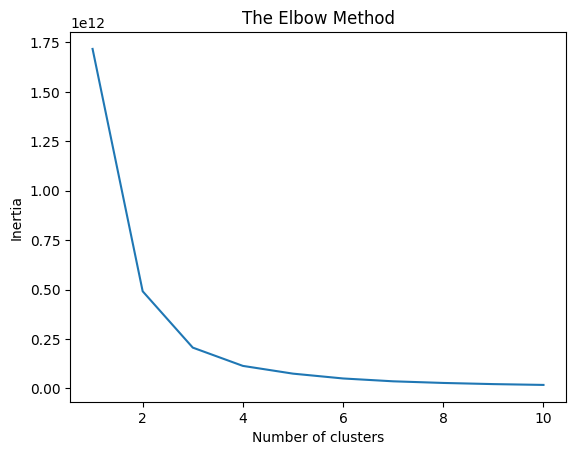

In [72]:
# Plot the elbow method
plt.plot(range(1,11), inertias)
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('The Elbow Method')
plt.show()
# Find the elbow point
diff = [inertias[i] - inertias[i+1] for i in range(len(inertias)-1)]
best_k = diff.index(max(diff)) + 2



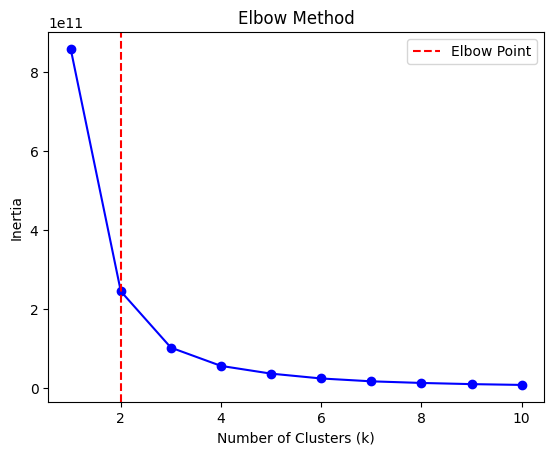

The best number of clusters based on the Elbow Method is: 2


In [73]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load the Diamonds dataset
df = sns.load_dataset('diamonds')

# Select relevant features for clustering
features = ['carat', 'depth', 'price']

# Extract the selected features from the dataset
X = df[features]

# Perform K-means clustering for different values of k
k_values = range(1, 11)  # Test k from 1 to 10
inertias = []  # List to store the inertia values

for k in k_values:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(X)
    inertias.append(kmeans.inertia_)

# Plot the Elbow curve
plt.plot(k_values, inertias, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method')

# Find the elbow point
diff = [inertias[i] - inertias[i+1] for i in range(len(inertias)-1)]
best_k = diff.index(max(diff)) + 2

# Add a vertical line to indicate the elbow point
plt.axvline(x=best_k, color='r', linestyle='--', label='Elbow Point')

plt.legend()
plt.show()

print("The best number of clusters based on the Elbow Method is:", best_k)

**2. Silouette Method**
One of the fundamental steps of an unsupervised learning algorithm is to determine the number of clusters into which the data may be divided. The silhouette algorithm is one of the many algorithms to determine the optimal number of clusters for an unsupervised learning technique.

Silhouette analysis can be used to study the separation distance between the resulting clusters. The silhouette plot displays a measure of how close each point in one cluster is to points in the neighboring clusters and thus provides a way to assess parameters like number of clusters visually. This measure has a range of [-1, 1].
it is calculated using the mean intra-cluster distance (a) and the mean nearest-cluster distance (b) for each sample. The Silhouette Coefficient for a sample is (b - a) / max(a, b). To clarify, b is the distance between a sample and the nearest cluster that the sample is not a part of. Note that Silhouette Coefficient is only defined if number of labels is 2 <= n_labels <= n_samples - 1.



In [77]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [78]:
# Load the Diamonds dataset
df = sns.load_dataset('diamonds')

# Select relevant features for clustering
features = ['carat', 'depth', 'price']

# Extract the selected features from the dataset
X = df[features]

In [81]:
# Perform K-means clustering for different values of k
k_values = range(2, 11)  # Test k from 2 to 10
silhouette_scores = []  # List to store the silhouette score

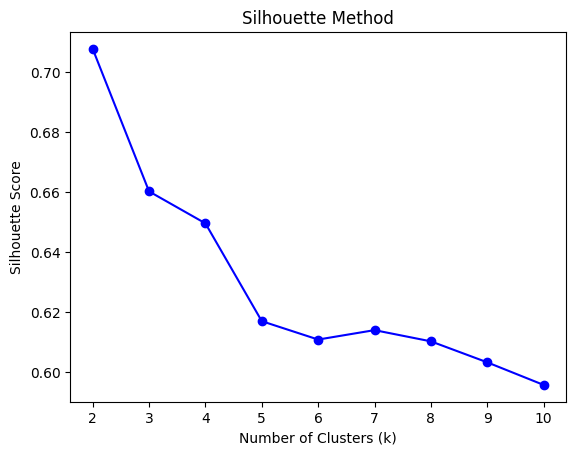

In [82]:

for k in k_values:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(X)
    labels = kmeans.labels_
    silhouette_scores.append(silhouette_score(X, labels))

# Plot the Silhouette scores
plt.plot(k_values, silhouette_scores, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Method')
plt.show()

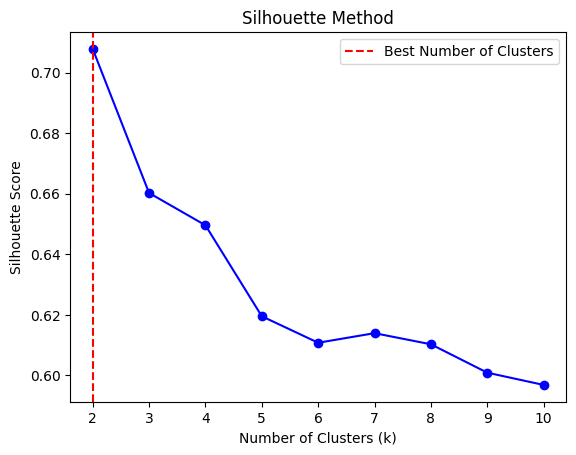

The best number of clusters based on the Silhouette Method is: 2


In [83]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

# Load the Diamonds dataset
df = sns.load_dataset('diamonds')

# Select relevant features for clustering
features = ['carat', 'depth', 'price']

# Extract the selected features from the dataset
X = df[features]

# Perform K-means clustering for different values of k
k_values = range(2, 11)  # Test k from 2 to 10
silhouette_scores = []  # List to store the silhouette scores

for k in k_values:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(X)
    labels = kmeans.labels_
    silhouette_scores.append(silhouette_score(X, labels))

# Plot the Silhouette scores
plt.plot(k_values, silhouette_scores, 'bo-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Method')
# Find the best number of clusters based on the Silhouette Method
best_k = k_values[silhouette_scores.index(max(silhouette_scores))]

# Add a vertical line to indicate the best number of clusters
plt.axvline(x=best_k, color='r', linestyle='--', label='Best Number of Clusters')

plt.legend()
plt.show()

print("The best number of clusters based on the Silhouette Method is:", best_k)

**Other evaluation methdos**
1. Calinski-Harabasz
2. Davies-Bouldin
3. Silhouette
4. Gap statistic
5. Bayesian information criterion (BIC)

## K-means++

The main difference between K-means and K-means++ lies in the initialization of cluster centroids. The standard K-means algorithm initializes centroids randomly, while K-means++ improves this initialization by selecting centroids in a more strategic and probabilistic manner. Here are the key distinctions:

**Centroid Initialization:**

K-means: In the original K-means algorithm, centroids are initialized randomly from the available data points.
K-means++: The K-means++ algorithm initializes the first centroid randomly, but subsequent centroids are chosen based on the distances to previously selected centroids. Data points farther away from existing centroids have a higher probability of being chosen.
**Impact on Clustering Results:**

K-means: The random initialization in K-means can lead to different clusterings each time the algorithm is run. It is more sensitive to the initial placement of centroids, and there is a higher chance of converging to suboptimal solutions.
K-means++: By strategically initializing centroids, K-means++ mitigates the sensitivity to initialization. It encourages a more spread-out initialization, which typically leads to better cluster formation and more reliable results. K-means++ tends to produce more stable and consistent clusters across different runs.
**Convergence and Efficiency:**

K-means: The random initialization in K-means may require more iterations to converge, as the initial centroids might be far from their optimal positions. It can result in slower convergence and higher computational costs.
K-means++: The improved initialization in K-means++ often leads to faster convergence since the initial centroids are better positioned. It reduces the number of iterations required to achieve convergence and can improve the algorithm's efficiency.
Overall, K-means++ is a modification of the standard K-means algorithm that provides a more effective and robust initialization scheme. By selecting initial centroids strategically, it enhances the quality of the clustering results and reduces sensitivity to the initial random initialization. K-means++ is widely used in practice as it improves the performance and stability of the K-means clustering algorithm.

In [84]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Load the Diamonds dataset
df = sns.load_dataset('diamonds')

# Select relevant features for clustering
features = ['carat', 'depth', 'price']

# Extract the selected features from the dataset
X = df[features]

In [87]:
# Perform K-means clustering with K-means++
k = 3  # Number of clusters
kmeans_pp = KMeans(n_clusters=k, init='k-means++', random_state=42)
kmeans_pp.fit(X)
# Perform standard K-means clustering
kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(X)


KMeans(n_clusters=3, random_state=42)

In [88]:
# Add cluster labels to the dataset
df['cluster_pp'] = kmeans_pp.labels_
df['cluster'] = kmeans.labels_

In [89]:
df.cluster.value_counts()

cluster
0    33005
2    15304
1     5631
Name: count, dtype: int64

In [90]:
df.cluster_pp.value_counts()

cluster_pp
0    33005
2    15304
1     5631
Name: count, dtype: int64

In [91]:
# let's use plotly and make plots

import plotly.express as px
fig = px.scatter(df, x='carat', y='price', color='cluster_pp')
fig.show()

In [93]:
# make a 3d plot in plotly
fig = px.scatter_3d(df, x='carat', y='depth', z='price', color='cluster_pp')
fig.show()

In [92]:
fig = px.parallel_coordinates(df, color='cluster_pp')
fig.show()

In [94]:
df = sns.load_dataset('iris')
df.drop('species', axis=1, inplace=True)
df.head()

,sepal_length,sepal_width,petal_length,petal_width
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2


In [95]:
# run kmeans clustering on df
kmeans = KMeans(n_clusters=3, init='k-means++', random_state=42)
kmeans.fit(df)

# Add cluster labels to the dataset
df['cluster'] = kmeans.labels_

df.head()

,sepal_length,sepal_width,petal_length,petal_width,cluster
0,5.1,3.5,1.4,0.2,1
1,4.9,3.0,1.4,0.2,1
2,4.7,3.2,1.3,0.2,1
3,4.6,3.1,1.5,0.2,1
4,5.0,3.6,1.4,0.2,1


In [97]:
# let's use plotly and make plots

import plotly.express as px
fig = px.scatter(df, x='sepal_length', y='petal_length', color='cluster')
fig.show()

In [98]:
# let's use plotly and make plots
iris = sns.load_dataset('iris')
import plotly.express as px
fig = px.scatter(iris, x='sepal_length', y='petal_length', color='species')
fig.show()

## Hierarchical Clustering

A Hierarchical clustering method works via grouping data into a tree of clusters. Hierarchical clustering begins by treating every data point as a separate cluster. Then, it repeatedly executes the subsequent steps:
Identify the 2 clusters which can be closest together, and
Merge the 2 maximum comparable clusters. We need to continue these steps until all the clusters are merged together.
In Hierarchical Clustering, the aim is to produce a hierarchical series of nested clusters. A diagram called Dendrogram (A Dendrogram is a tree-like diagram that statistics the sequences of merges or splits) graphically represents this hierarchy and is an inverted tree that describes the order in which factors are merged (bottom-up view) or clusters are broken up (top-down view).

Hierarchical clustering is a method of cluster analysis in data mining that creates a hierarchical representation of the clusters in a dataset. The method starts by treating each data point as a separate cluster and then iteratively combines the closest clusters until a stopping criterion is reached. The result of hierarchical clustering is a tree-like structure, called a dendrogram, which illustrates the hierarchical relationships among the clusters.

**Hierarchical clustering has several advantages over other clustering methods**
The ability to handle non-convex clusters and clusters of different sizes and densities.
The ability to handle missing data and noisy data.
The ability to reveal the hierarchical structure of the data, which can be useful for understanding the relationships among the clusters

**Drawbacks of Hierarchical Clustering**
The need for a criterion to stop the clustering process and determine the final number of clusters.
The computational cost and memory requirements of the method can be high, especially for large datasets.
The results can be sensitive to the initial conditions, linkage criterion, and distance metric used.
In summary, Hierarchical clustering is a method of data mining that groups similar data points into clusters by creating a hierarchical structure of the clusters. 
This method can handle different types of data and reveal the relationships among the clusters. However, it can have high computational cost and results can be sensitive to some conditions



**Types of Hierarchical Clustering**

Basically, there are two types of hierarchical Clustering:

Agglomerative Clustering
Divisive clustering

**1. Agglomerative Clustering**
Initially consider every data point as an individual Cluster and at every step, merge the nearest pairs of the cluster. (It is a bottom-up method). At first, every dataset is considered an individual entity or cluster. At every iteration, the clusters merge with different clusters until one cluster is formed. 

**The algorithm for Agglomerative Hierarchical Clustering is:**

Calculate the similarity of one cluster with all the other clusters (calculate proximity matrix)
Consider every data point as an individual cluster
Merge the clusters which are highly similar or close to each other.
Recalculate the proximity matrix for each cluster
Repeat Steps 3 and 4 until only a single cluster remains.
Let’s see the graphical representation of this algorithm using a dendrogram. 
Let’s say we have six data points A, B, C, D, E, and F.
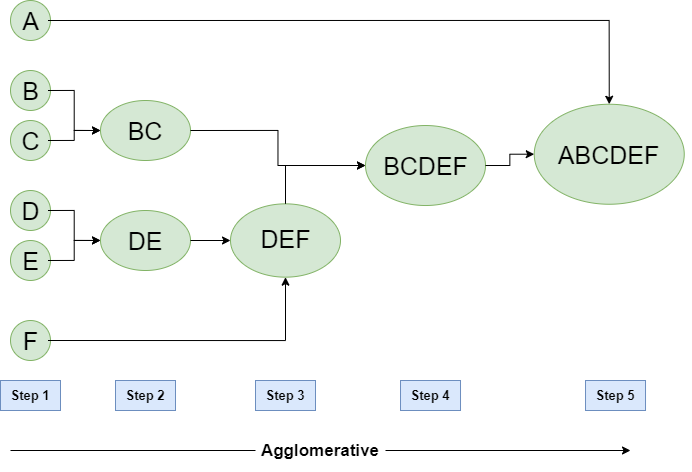


**2. Divisive Hierarchical clustering**

We can say that Divisive Hierarchical clustering is precisely the opposite of Agglomerative Hierarchical clustering. In Divisive Hierarchical clustering, we take into account all of the data points as a single cluster and in every iteration, we separate the data points from the clusters which aren’t comparable. In the end, we are left with N clusters. 
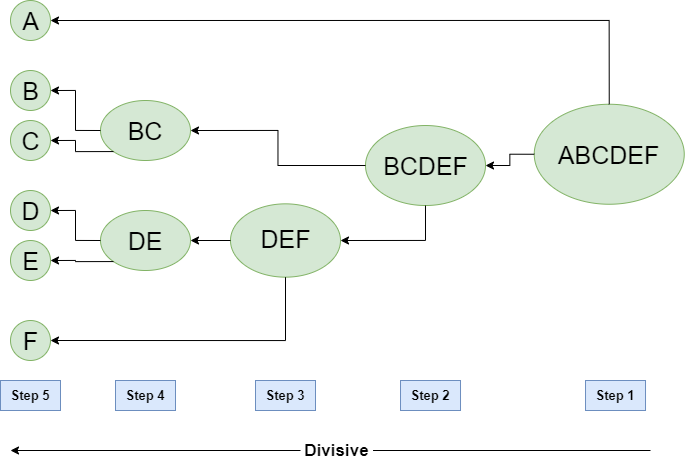

In [101]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch
from sklearn.datasets import make_blobs

In [102]:
# remove warnings
import warnings
warnings.filterwarnings('ignore')

In [103]:
# Generate a random dataset with 100 samples and 3 features
X, y = make_blobs(n_samples=100, centers=11, n_features=3, random_state=42)

In [104]:
# Perform hierarchical clustering with the AgglomerativeClustering algorithm
clustering = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')
clustering.fit(X)

AgglomerativeClustering(affinity='euclidean', n_clusters=3)

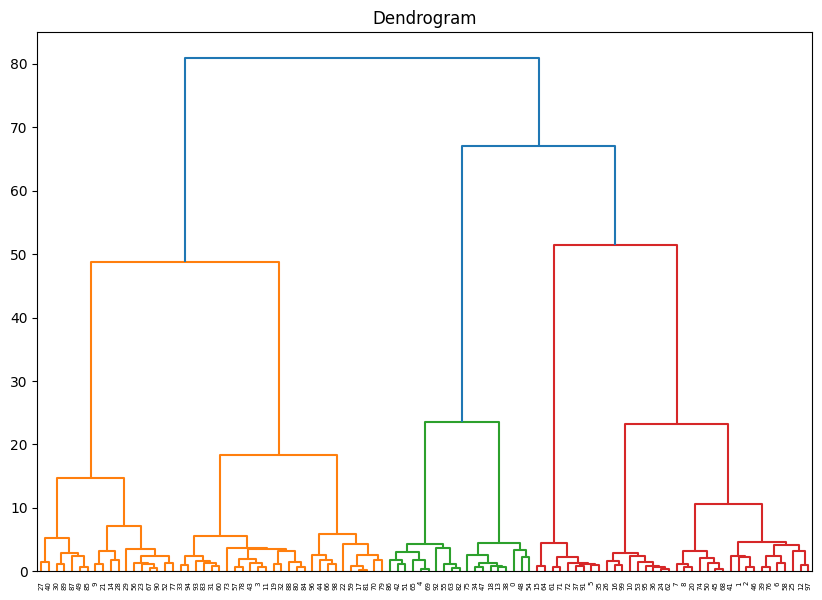

In [105]:
# Plot the dendrogram
plt.figure(figsize=(10, 7))
plt.title("Dendrogram")
dendrogram = sch.dendrogram(sch.linkage(X, method='ward'))
plt.show()

In [114]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage

In [107]:
# Load the tips dataset from seaborn
tips = sns.load_dataset('tips')

# Select relevant features for clustering
features = ['total_bill', 'tip']

# Extract the selected features from the dataset
X = tips[features]

In [108]:
# Perform Agglomerative clustering
n_clusters = 5  # Number of clusters
agg_clustering = AgglomerativeClustering(n_clusters=n_clusters)
agg_labels = agg_clustering.fit_predict(X)

In [109]:
# Add cluster labels to the dataset
tips['cluster'] = agg_labels

In [110]:
tips.head()

,total_bill,tip,sex,smoker,day,time,size,cluster
0,16.99,1.01,Female,No,Sun,Dinner,2,0
1,10.34,1.66,Male,No,Sun,Dinner,3,1
2,21.01,3.50,Male,No,Sun,Dinner,3,0
3,23.68,3.31,Male,No,Sun,Dinner,2,3
4,24.59,3.61,Female,No,Sun,Dinner,4,3


Text(0, 0.5, 'Tip')

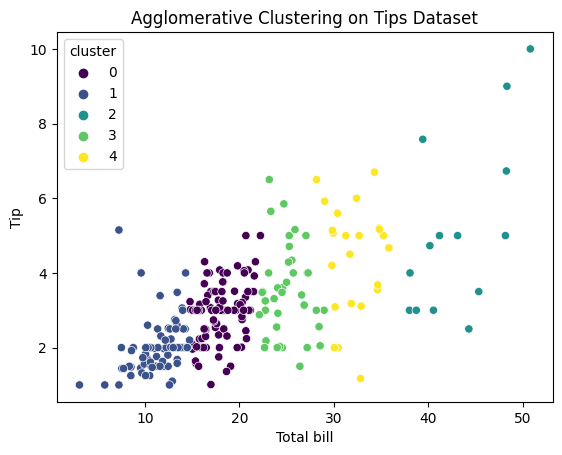

In [112]:
sns.scatterplot(data=tips, x='total_bill', y='tip', hue='cluster', palette='viridis')
plt.title("Agglomerative Clustering on Tips Dataset")
plt.xlabel("Total bill")
plt.ylabel("Tip")

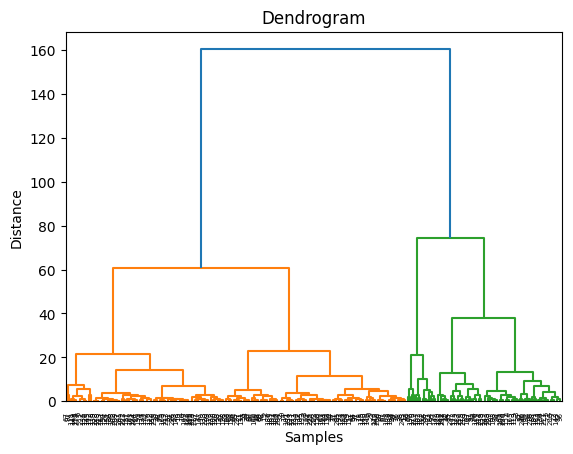

In [116]:
# Plot the dendrogram
dendrogram(linkage(X, method="ward"))
plt.title('Dendrogram')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.show()

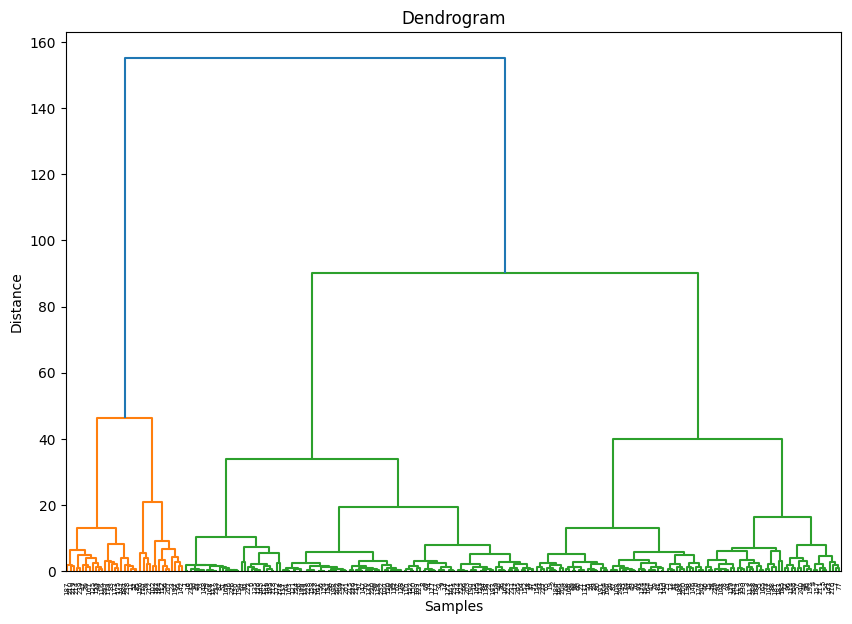

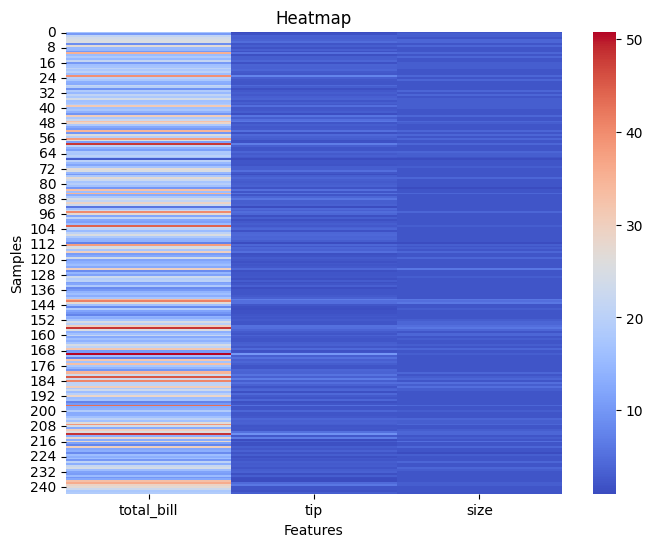

In [117]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage

# Load the tips dataset from seaborn
tips = sns.load_dataset('tips')

# Select relevant features for clustering
features = ['total_bill', 'tip', 'size']

# Extract the selected features from the dataset
X = tips[features]

# Compute the linkage matrix
linkage_matrix = linkage(X, method='ward')

# Plot the dendrogram
plt.figure(figsize=(10, 7))
dendrogram(linkage_matrix)
plt.title('Dendrogram')
plt.xlabel('Samples')
plt.ylabel('Distance')
plt.show()

# Plot the heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(X, cmap='coolwarm')
plt.title('Heatmap')
plt.xlabel('Features')
plt.ylabel('Samples')
plt.show()

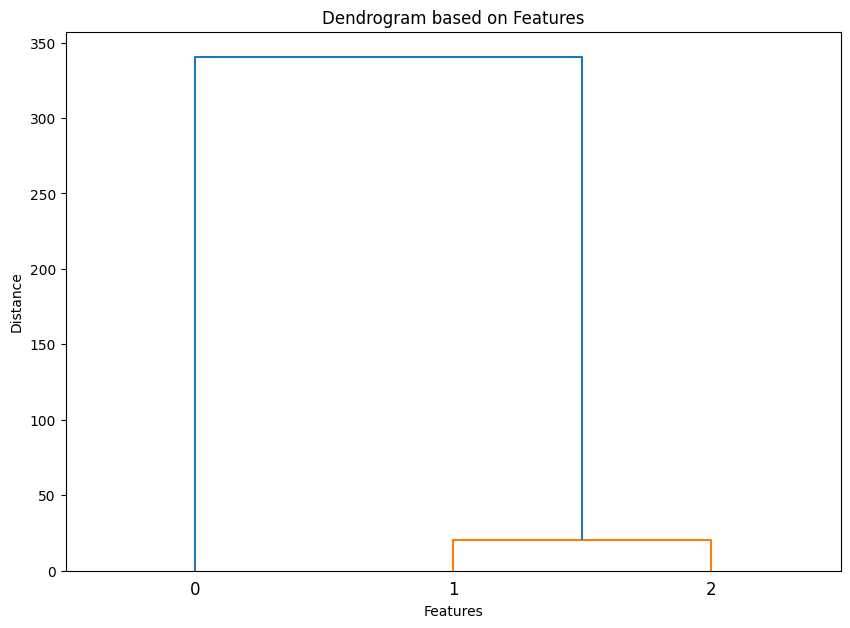

In [118]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage

# Load the tips dataset from seaborn
tips = sns.load_dataset('tips')

# Select relevant features for clustering
features = ['total_bill', 'tip', 'size']

# Extract the selected features from the dataset
X = tips[features]

# Transpose the data matrix
X_transposed = X.transpose()

# Compute the linkage matrix
linkage_matrix = linkage(X_transposed, method='ward')

# Plot the dendrogram
plt.figure(figsize=(10, 7))
dendrogram(linkage_matrix)
plt.title('Dendrogram based on Features')
plt.xlabel('Features')
plt.ylabel('Distance')
plt.show()